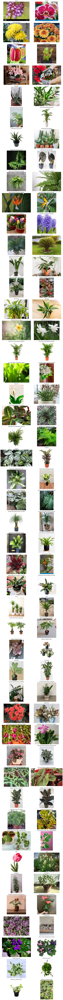

In [2]:
import os
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import warnings
warnings.filterwarnings("ignore")
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model


dataset_path = '/kaggle/input/house-plant-species/house_plant_species'

classes = os.listdir(dataset_path)

num_images_per_class = 2
num_classes = len(classes)

plt.figure(figsize=(12, num_classes * 4))

for i, class_name in enumerate(classes):
    class_folder = os.path.join(dataset_path, class_name)
    images = os.listdir(class_folder)

    
    for j in range(min(num_images_per_class, len(images))):
        img_path = os.path.join(class_folder, images[j])
        img = Image.open(img_path)

        plt.subplot(num_classes, num_images_per_class, i * num_images_per_class + j + 1)
        plt.imshow(img)
        plt.axis('off')
        plt.title(class_name)

plt.tight_layout()
plt.show()


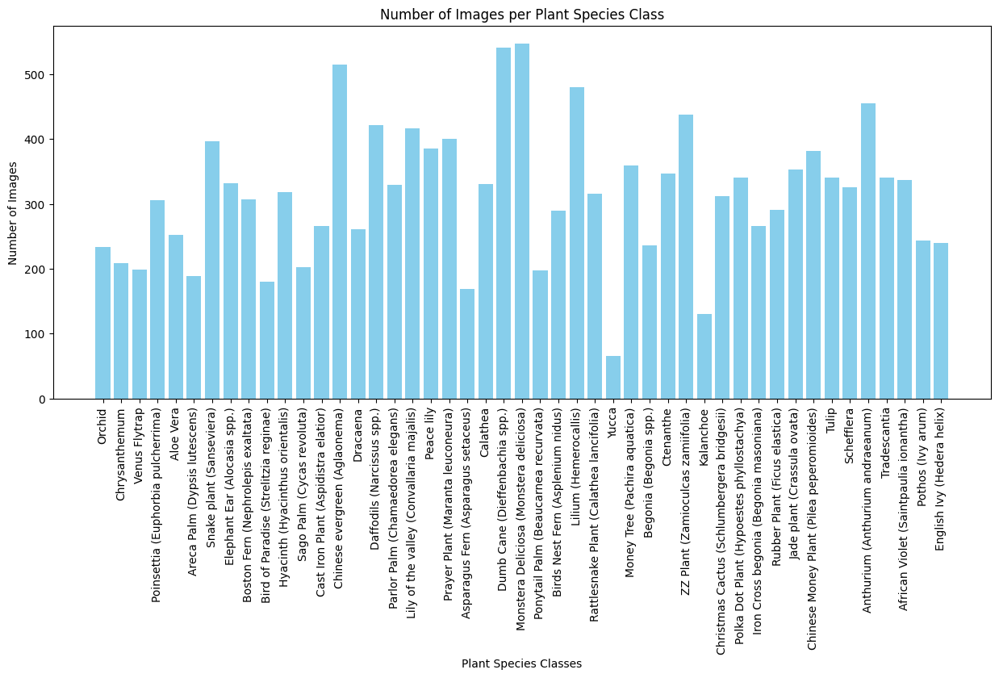

In [3]:
image_counts = []


for class_name in classes:
    class_folder = os.path.join(dataset_path, class_name)
    images = os.listdir(class_folder)
    image_counts.append(len(images))

plt.figure(figsize=(15, 6))
plt.bar(classes, image_counts, color='skyblue')
plt.xticks(rotation=90)  # Rotate class names for better visibility
plt.xlabel('Plant Species Classes')
plt.ylabel('Number of Images')
plt.title('Number of Images per Plant Species Class')
plt.show()


# **Model**

In [4]:
img_height, img_width = 224, 224
batch_size = 32


train_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2)

train_generator = train_datagen.flow_from_directory(
    dataset_path,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    dataset_path,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation'
)

#  pretrained EfficientNetB0 model
base_model = EfficientNetB0(weights='imagenet', include_top=False)


x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(128, activation='relu')(x)
predictions = Dense(len(train_generator.class_indices), activation='softmax')(x)


Found 11715 images belonging to 47 classes.
Found 2905 images belonging to 47 classes.


In [5]:
model = Model(inputs=base_model.input, outputs=predictions)

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
history = model.fit(train_generator, validation_data=validation_generator, epochs=5)

Epoch 1/5


I0000 00:00:1741072375.092346     563 service.cc:145] XLA service 0x7a1424005060 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1741072375.092403     563 service.cc:153]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1741072375.092408     563 service.cc:153]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
I0000 00:00:1741072420.199381     563 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


211/367 ━━━━━━━━━━━━━━━━━━━━ 2:22 912ms/step - accuracy: 0.4698 - loss: 2.1039

I0000 00:00:1741072611.755486     564 asm_compiler.cc:369] ptxas warning : Registers are spilled to local memory in function 'input_multiply_reduce_fusion', 220 bytes spill stores, 220 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'input_reduce_fusion', 24 bytes spill stores, 24 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'input_reduce_fusion_2', 24 bytes spill stores, 24 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'input_reduce_fusion_3', 32 bytes spill stores, 32 bytes spill loads



367/367 ━━━━━━━━━━━━━━━━━━━━ 449s 1s/step - accuracy: 0.5518 - loss: 1.7437 - val_accuracy: 0.0334 - val_loss: 4.1370
Epoch 2/5
367/367 ━━━━━━━━━━━━━━━━━━━━ 319s 856ms/step - accuracy: 0.8676 - loss: 0.4528 - val_accuracy: 0.6059 - val_loss: 1.5291
Epoch 3/5
367/367 ━━━━━━━━━━━━━━━━━━━━ 314s 842ms/step - accuracy: 0.9090 - loss: 0.2944 - val_accuracy: 0.7969 - val_loss: 0.7748
Epoch 4/5
367/367 ━━━━━━━━━━━━━━━━━━━━ 316s 847ms/step - accuracy: 0.9263 - loss: 0.2366 - val_accuracy: 0.8389 - val_loss: 0.6129
Epoch 5/5
367/367 ━━━━━━━━━━━━━━━━━━━━ 314s 842ms/step - accuracy: 0.9370 - loss: 0.1985 - val_accuracy: 0.8176 - val_loss: 0.7495


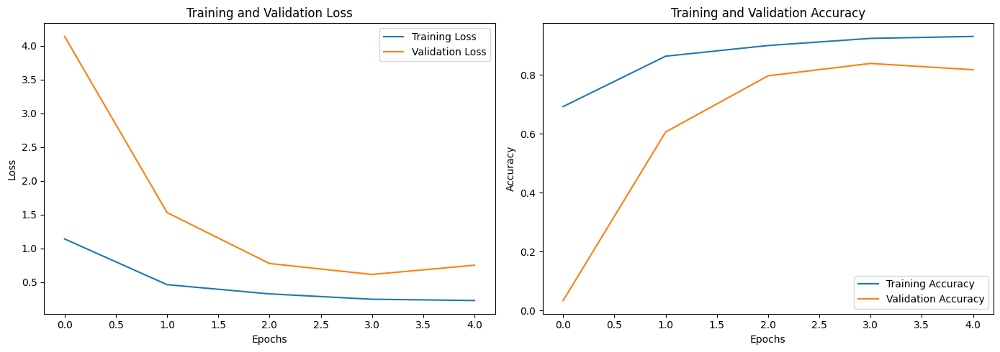

In [6]:
plt.figure(figsize=(14, 5))

plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Plotting training and validation accuracy
plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()

In [10]:
import tensorflow as tf
model.save("efficientnet_b0.h5")